# Functional Connectivity Second Level Analysis
Load group connectivity maps and run statistical analyses
1. Test for statistical significance of correlation maps (Is the connectivity strength significantly different from zero?)
2. Test for difference between maps of different ROIs
3. Save t-test map
4. Save significant clusters as labels - this is done manually in Freeview
5. Load clusters, extract correlation values from group map and save as dataframe
6. calculate correlations between connectivity values and reading scores

In [1]:
# Compare and analyze seed-based connectivity maps
# import
from nilearn import datasets
from nilearn import surface
from nilearn import plotting
from nilearn import image
import numpy as np
import pandas as pd
import glob
import os
import nilearn
#import scipy as scp
from nilearn import signal
from scipy import stats
import nibabel as nib
from os.path import exists
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [2]:
# Define paths:
projectdir = '/scratch/groups/jyeatman/HBN_FC/'
space = 'surface' # volume or surface analysis
datadir = projectdir + space + '/Atlas/statMaps/'
analysesdir = projectdir + space + '/Atlas/analyses/'

# Load fsaverage
fsaverage = datasets.fetch_surf_fsaverage('fsaverage',data_dir = '/home/groups/jyeatman/software')

# Load LH surface to get its size
white_left = surface.load_surf_data(fsaverage['white_left'])
# Load RH surface to get its size
white_right = surface.load_surf_data(fsaverage['white_right'])

# Paths to surface ROIs from Emily:
Atlas = True
# Which task
task = 'rest' # options are 'rest' or 'movie'
hemi = 'left' # right or left
seed_hemi = 'left'
# which correlation to save
corr_type = 'fisherz' # options are 'rval', 'fisherz'

saveFigures = False


/home/groups/jyeatman/software/mayay/anaconda3/envs/FC/lib/python3.9/site-packages/nilearn/surface/surface.py:671: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.asarray([arr.data for arr in gifti_img.darrays]).T.squeeze()


In [3]:
# Load curated behavioral data
subject_file = projectdir + 'subs_preprocessed_restingstate_movieDM_meanFD05_SNR15_FD05_90_WIAT_FilteredAfterScrubbing_0.5_0.2.csv'
if task == 'rest':
    subject_file = projectdir+ 'subs_preprocessed_onlyrest_meanFD05_SNR15_FD05_90_WIAT.csv'
elif task == 'movie':
    subject_file = projectdir+ 'subs_preprocessed_onlymovie_meanFD05_SNR15_FD05_90_WIAT.csv'

sub_data = pd.read_csv(subject_file)
subs = sub_data['participant_id']
sub_count = len(subs)
print(sub_count)

224


In [4]:
# Get atlas and visualize different ROIs
destrieux_atlas = datasets.fetch_atlas_surf_destrieux()
parcellation = destrieux_atlas['map_left']
labels = destrieux_atlas['labels']

# Fsaverage5 surface template
#fsaverage = datasets.fetch_surf_fsaverage()
roi_names = ['S_front_inf','S_intrapariet_and_P_trans']

In [5]:
# First we load all seed-based connectivity maps that were pre-saved by HBN_FC.py
if hemi == 'left':
    roi_maps = np.zeros(shape = (sub_count,white_left[0].shape[0],len(roi_names)))
    #roi_map shape is subjects * vertices * seed
else:
    roi_maps = np.zeros(shape = (sub_count,white_right[0].shape[0],len(roi_names)))

# Load all data into one array
for roi_i in range(len(roi_names)):
    cur_roi_path = datadir + 'GroupMap_task-' + task + '_' + roi_names[roi_i] + '_N' + str(sub_count)+ '_fisherz_' + hemi[0] + 'h.npy'
    print('Loading ' + cur_roi_path)
    cur_roi_map = np.load(cur_roi_path)
    cur_roi_mean = np.nanmean(cur_roi_map,axis=0)
    roi_maps[:,:,roi_i] = cur_roi_map

roi_short_names = roi_names

Loading /scratch/groups/jyeatman/HBN_FC/surface/Atlas/statMaps/GroupMap_task-rest_S_front_inf_N224_fisherz_lh.npy
Loading /scratch/groups/jyeatman/HBN_FC/surface/Atlas/statMaps/GroupMap_task-rest_S_intrapariet_and_P_trans_N224_fisherz_lh.npy


In [6]:
cur_roi_mean.shape

(163842,)

### Plot seed-based connectivity

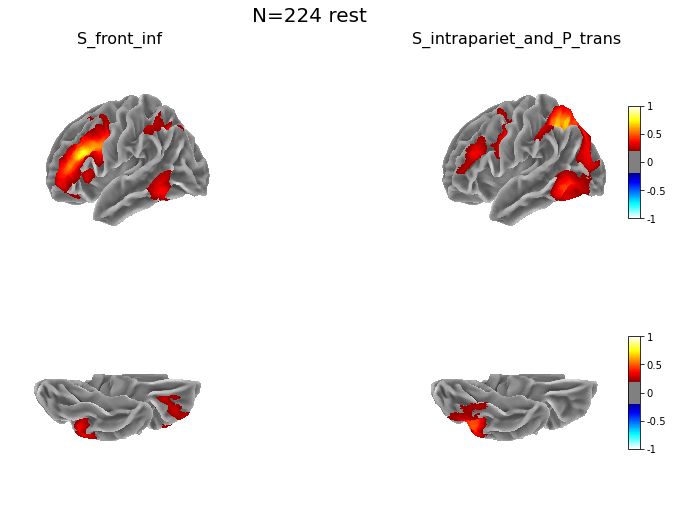

In [7]:
# Plot mean group connectivity maps
# create main Figure
#fig, axes = plt.subplots(2,len(roi_names),figsize=(10,4),sharey=True,subplot_kw={'projection': '3d'})
fig, axes = plt.subplots(2,len(roi_names),figsize=(10,7),subplot_kw={'projection': '3d'},constrained_layout=True)
#fig.tight_layout(pad=0, w_pad=0, h_pad=0)
#fig.constrained_layout()

for roi_i in range(len(roi_names)):
    # plot mean group connectivity for each seed ROI
    cur_roi_map = roi_maps[:,:,roi_i]
    cur_roi_mean = np.nanmean(cur_roi_map,axis=0)
    
    if roi_i == (len(roi_names)-1):
        do_cb=True
    else:
        do_cb=False
        
    plotting.plot_surf_stat_map(fsaverage['white_'+hemi], stat_map=cur_roi_mean,
    hemi=hemi, threshold = .2, vmax=1, view='lateral', colorbar=do_cb,axes=axes[0,roi_i],
    bg_map=fsaverage['curv_'+hemi],title=None, output_file = None)
    axes[0,roi_i].set_title(roi_short_names[roi_i],fontsize=16)
    
    plotting.plot_surf_stat_map(fsaverage['white_'+hemi], stat_map=cur_roi_mean,
    hemi=hemi, threshold = .2, vmax=1, view='ventral', colorbar=do_cb,axes=axes[1,roi_i],
    bg_map=fsaverage['curv_'+hemi],title=None, output_file = None)
    #axes[1,roi_i].set_title(roi_names[roi_i]) # we dont need extra titles in the second row

   # This inteactive plots doesn't work in a loop
   # plotting.view_surf(fsaverage['white_left'], surf_map=cur_roi_mean,
   # threshold = .15, vmax=1, colorbar=True,
   # bg_map=fsaverage['curv_left'],title='Group map N=' + str(sub_count) + ' ' + roi_names[roi_i])

fig.suptitle('N=' + str(sub_count) + ' ' + task,fontsize=20)
#plt.subplots_adjust(left=0.1,bottom=0.1, right=0.9, top=0.9, wspace=0,hspace=0.2) # this fixes the titles but messes up the colorbars

if saveFigures:
    figurename = analysesdir + 'GroupMean_N' + str(sub_count) + '_' + task + '_' + hemi
    fig.savefig(figurename + '.png')

### Test for group-level significance of seed-based correlation maps for each ROI
This is done by a 1-sample t-test: is the population mean of R-values in this vertex significanly different from zero?

In [ ]:
t_thresh = 9
# create Figure
r_fig, r_axes = plt.subplots(2,len(roi_names),figsize=(10,7),sharey=True,subplot_kw={'projection': '3d'})

for roi_i in range(len(roi_names)):
    cur_roi_map = roi_maps[:,:,roi_i]
    t_vals, p_vals = stats.ttest_1samp(cur_roi_map, 0)
    z_vals = stats.norm.isf(p_vals)
    # I am not sure why we are plotting z_vals rather than t_vals. I followed this tutorial:
    # https://nilearn.github.io/stable/auto_examples/07_advanced/plot_surface_bids_analysis.html#sphx-glr-auto-examples-07-advanced-plot-surface-bids-analysis-py
    # Plot
    plotting.plot_surf_stat_map(fsaverage['white_'+hemi], stat_map=z_vals,
    hemi=hemi, threshold = t_thresh, vmax=20, view='lateral', colorbar=True,axes=r_axes[0,roi_i],
    bg_map=fsaverage['curv_'+hemi],title=None)
    r_axes[0,roi_i].set_title(roi_short_names[roi_i],fontsize=16)

    plotting.plot_surf_stat_map(fsaverage['white_'+hemi], stat_map=z_vals,
    hemi=hemi, threshold = t_thresh, vmax=20, view='ventral', colorbar=True,axes=r_axes[1,roi_i],
    bg_map=fsaverage['curv_'+hemi],title=None)

    tmap_fileName=analysesdir + 'Group_Ttest_N' + str(sub_count) + '_' + task + '_' + hemi + '_' + roi_short_names[roi_i] + '.curv'
    nib.freesurfer.io.write_morph_data(tmap_fileName,z_vals)
# set the spacing between subplots
# plt.subplots_adjust(left=0.1,
#                     bottom=0.1, 
#                     right=0.2, 
#                     top=0.2, 
#                     wspace=0.4, 
#                     hspace=0.4)
# FIXME - subtitles are cut off and background is transparent
# Looks like the colorbars are a different axis.
# find a way to fix spacing between plots and plot only a single colorbar at the right
if saveFigures:
    figurename = analysesdir + 'Group_Ttest_N' + str(sub_count) + '_' + task + '_' + hemi
    r_fig.savefig(figurename + '.png')

### Test for difference between seed-based maps
This is done by a 2-sample paired t-test: is the difference between r-values in each vertex significantly different from zero accross participants?

In [14]:
# Calculate thresh for visualization
p_threshold = 0.000000001
t_threshold = stats.t.isf(p_threshold/2, sub_count-1)
print(t_threshold)
#verify
print(stats.t.sf(t_threshold, sub_count-1)*2)

6.3818521399836365
1.0000000000015055e-09


In [15]:
print(stats.t.sf(6, sub_count-1)*2)

7.900125752916481e-09


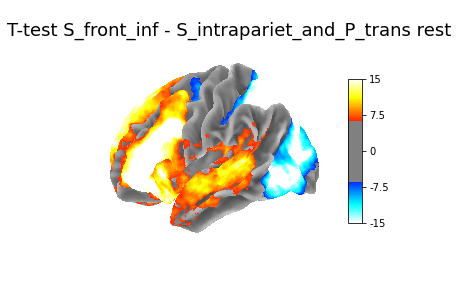

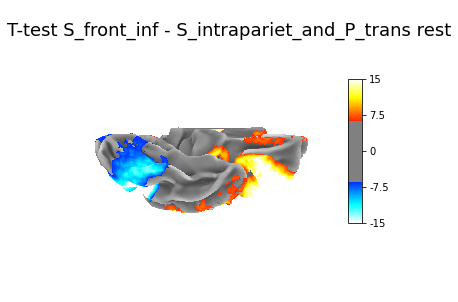

In [16]:
# Run a dependent sample t-test between the two maps
roi1_ind = 0
roi2_ind = 1
ttest_res = stats.ttest_rel(roi_maps[:,:,roi1_ind],roi_maps[:,:,roi2_ind],nan_policy='omit')
# Plot t-test result as a map
plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
hemi='left', threshold = t_threshold, vmax=15, view='lateral', colorbar=True,
bg_map=fsaverage['curv_left'], title='T-test '+ roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind] + ' ' + task, output_file = None)
print()
#figurename = analysesdir + 'Group_Ttest_N' + str(sub_count) + roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind]+'_' + task + '_' + hemi
#plt.savefig(figurename + '.png')
plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
hemi='left', threshold = t_threshold, vmax=15, view='ventral', colorbar=True,
bg_map=fsaverage['curv_left'], title='T-test '+ roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind] + ' ' + task, output_file = None)
print()


## Try to plot ROI contour on map

In [10]:
destrieux_atlas = datasets.fetch_atlas_surf_destrieux()
parcellation = destrieux_atlas['map_left']

In [11]:
# these are the regions we want to outline
regions_dict = {b'S_front_inf': 'IFG',
                b'S_intrapariet_and_P_trans': 'IPS'}

regions_dict = {b'G_postcentral': 'Postcentral gyrus',
                b'G_precentral': 'Precentral gyrus'}

# get indices in atlas for these labels
regions_indices = [np.where(np.array(destrieux_atlas['labels']) == region)[0][0]
                   for region in regions_dict]

labels = list(regions_dict.values())
print(regions_indices)
print(labels)

[28, 29]
['Postcentral gyrus', 'Precentral gyrus']


In [13]:
myfile = '/scratch/groups/jyeatman/HBN_FC/volume/statMaps/sub-NDARAA948VFH_task-movie_VWFA2_zMap.nii.gz'
mymap=image.load_img(myfile)
texture = surface.vol_to_surf(mymap,surf_mesh=fsaverage['white_left'])

/home/groups/jyeatman/software/mayay/anaconda3/envs/FC/lib/python3.9/site-packages/nilearn/surface/surface.py:464: RuntimeWarning: Mean of empty slice
  texture = np.nanmean(all_samples, axis=2)


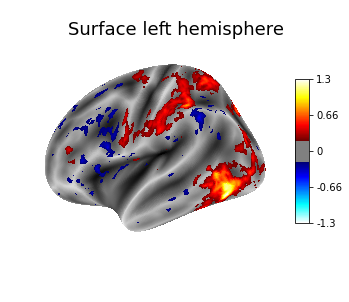

In [15]:
my_figure = plotting.plot_surf_stat_map(fsaverage['infl_left'], texture, hemi='left',
                                     title='Surface left hemisphere',
                                     colorbar=True, threshold=.2,
                                     bg_map=fsaverage['sulc_left'])


In [19]:
regions_indices

[28, 29]

In [24]:
roidir='/home/groups/jyeatman/ROI_Atlases/visfAtlas/Emily/'
roi_names = ['MPM_lh_IOS.label','lh_pOTS_chars.label','lh_mOTS_chars.label']
cur_roi = roidir + roi_names[1]

ValueError: Vertices in parcellation do not form region.

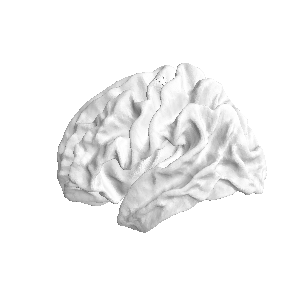

In [27]:
plotting.plot_surf_contours(fsaverage['white_left'], roi_map=cur_roi,
                            levels=None, figure=None, legend=True,
                            colors=None)

In [ ]:

cur_roi = surface.load_surf_data(roidir + roi_names[rr])
cur_roi = cur_roi.astype(int) 

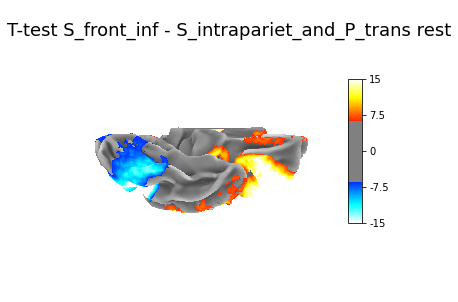

In [20]:
figure = plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
hemi='left', threshold = t_threshold, vmax=15, view='ventral', colorbar=True,
bg_map=fsaverage['curv_left'], title='T-test '+ roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind] + ' ' + task, output_file = None)
print()


In [29]:
plotting.plot_surf_contours(fsaverage['white_left'], parcellation, labels=[labels[1]],
                            levels=[regions_indices[1]], view='ventral',figure=figure, legend=True,
                            colors=['g'])
plotting.show()

ValueError: Vertices in parcellation do not form region.

In [28]:
# Try to run exactly as appears in the tutorial
import numpy as np

destrieux_atlas = datasets.fetch_atlas_surf_destrieux()
parcellation = destrieux_atlas['map_right']

# these are the regions we want to outline
regions_dict = {b'G_postcentral': 'Postcentral gyrus',
                b'G_precentral': 'Precentral gyrus'}

# get indices in atlas for these labels
regions_indices = [np.where(np.array(destrieux_atlas['labels']) == region)[0][0]
                   for region in regions_dict]

labels = list(regions_dict.values())


ValueError: Vertices in parcellation do not form region.

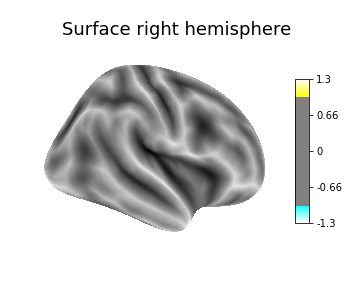

In [29]:
figure = plotting.plot_surf_stat_map(fsaverage.infl_right, texture, hemi='right',
                                     title='Surface right hemisphere',
                                     colorbar=True, threshold=1.,
                                     bg_map=fsaverage.sulc_right)

plotting.plot_surf_contours(fsaverage.infl_right, parcellation, labels=labels,
                            levels=regions_indices, figure=figure, legend=True,
                            colors=['g', 'k'])
plotting.show()

In [31]:
# syntax for interactive viewing
view = plotting.view_surf(fsaverage['white_left'], surf_map=ttest_res.statistic,
threshold = t_threshold, vmax=15, colorbar=True,
bg_map=fsaverage['curv_left'],title='pOTS-mOTS')

view
view.save_as_html(analysesdir + 'GroupMap_task-' + task + '_N_'+ str(sub_count)+ '_ttest_view_' + hemi + '_thresh_'+ str(round(t_threshold, 2)))

In [19]:
parcellation

array([29, 27,  8, ..., 23, 62, 62], dtype=int32)

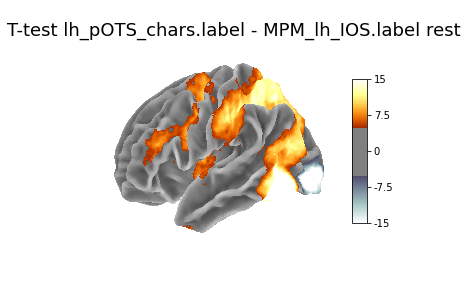

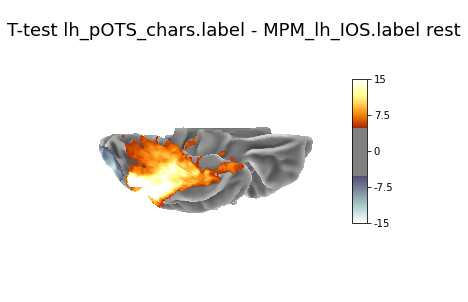

In [32]:
# Same for IOS and pOTS
# Run a dependent sample t-test between the two maps
roi1_ind = 1
roi2_ind = 0
ttest_res = stats.ttest_rel(roi_maps[:,:,roi1_ind],roi_maps[:,:,roi2_ind],nan_policy='omit')
# Plot t-test result as a map
plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
hemi='left', threshold = t_threshold, vmax=15, view='lateral', colorbar=True,cmap='hot_black_bone_r',
bg_map=fsaverage['curv_left'], title='T-test '+ roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind] + ' ' + task, output_file = None)
print()
plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
hemi='left', threshold = t_threshold, vmax=15, view='ventral', colorbar=True,cmap='hot_black_bone_r',
bg_map=fsaverage['curv_left'], title='T-test '+ roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind] + ' ' + task, output_file = None)
print()

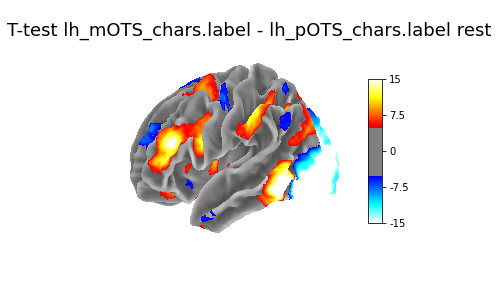

In [33]:
# Same for IOS and mOTS
# Run a dependent sample t-test between the two maps
roi1_ind = 2
roi2_ind = 1
ttest_res = stats.ttest_rel(roi_maps[:,:,roi1_ind],roi_maps[:,:,roi2_ind],nan_policy='omit')
# Plot t-test result as a map
plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
hemi='left', threshold = t_threshold, vmax=15, view='lateral', colorbar=True,
bg_map=fsaverage['curv_left'], title='T-test '+ roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind] + ' ' + task, output_file = None)
print()

In [35]:
# save this t-test map as a gii and open in freeview for labeling clusters manually
roi1_ind = 1
roi2_ind = 2
ttest_res = stats.ttest_rel(roi_maps[:,:,roi1_ind],roi_maps[:,:,roi2_ind],nan_policy='omit')
# MAKE SURE YOU ARE USING THE RIGHT ROI INDICES!
tmap_fileName = datadir + 'ttest_' + task + '_N' + str(sub_count) + '_'+ os.path.splitext(roi_names[roi1_ind])[0] + '_' + os.path.splitext(roi_names[roi2_ind])[0] + '_lh.curv'
nib.freesurfer.io.write_morph_data(tmap_fileName,ttest_res.statistic)

In [6]:
# I opened this curv file as an overlay in Freeview
# saved the clusters manually as labels
# I have two versions, for threshold=4 and threshold=5, saved in separate subfolders
thresh = 638
cluster_dir = projectdir + 'ROIs/rest_ttest_N'+str(sub_count)+'_thresh'+str(thresh) + '/'
clusters = glob.glob(cluster_dir + '*.label')
clusters = [os.path.basename(x) for x in glob.glob(cluster_dir + '*.label')]
clusters

['LeftSFG.label',
 'LeftOFC.label',
 'LeftIFGop.label',
 'LeftIFGtri.label',
 'LeftIPS.label']

In [7]:
# Create a dataframe with connectivity values extracted from each subject for each seed
roi_map = np.zeros(white_left[0].shape[0])
roi_df = pd.DataFrame()

# loop through all seed ROI + cluster combinations
for roi_i in range(len(roi_names)):
    for cluster_i in range(len(clusters)):  
        cluster_name = os.path.splitext(clusters[cluster_i])[0]
        cur_cluster = surface.load_surf_data(cluster_dir + clusters[cluster_i])
        # color the cluster so we can plot them in one map
        roi_map[cur_cluster] = cluster_i+1
        # Extract values from group correlation map
        roi_r_vals = np.nanmean(roi_maps[:,cur_cluster,roi_i], axis=1)
      #  print(roi_r_vals.shape)
        roi_df[roi_short_names[roi_i]+ '_' +cluster_name] = roi_r_vals 


In [8]:
roi_df

,IOS_LeftSFG,IOS_LeftOFC,IOS_LeftIFGop,IOS_LeftIFGtri,IOS_LeftIPS,pOTS_LeftSFG,pOTS_LeftOFC,pOTS_LeftIFGop,pOTS_LeftIFGtri,pOTS_LeftIPS,mOTS_LeftSFG,mOTS_LeftOFC,mOTS_LeftIFGop,mOTS_LeftIFGtri,mOTS_LeftIPS
0,0.073429,0.117430,0.043757,-0.035983,-0.006773,0.113335,0.107588,0.034037,-0.085842,0.053459,0.153828,0.075020,0.034419,0.196973,0.210679
1,0.065741,-0.051199,0.044056,-0.045198,0.088691,0.145247,-0.027379,0.291172,0.053839,0.083301,0.126286,0.030926,0.357580,0.051714,0.119274
2,-0.099171,0.048088,0.093079,0.044974,-0.028967,-0.040261,0.047127,0.177120,0.070612,0.007616,0.031443,0.003674,0.247600,0.187558,0.117735
3,-0.198892,-0.071500,-0.036030,-0.085354,-0.023295,-0.092028,-0.078090,-0.035207,-0.054805,0.064345,0.205027,0.055419,0.083683,0.192241,0.230880
4,0.119758,0.094280,0.163259,0.139464,0.174511,0.267451,0.126534,0.209068,0.195857,0.312963,0.227645,0.176459,0.185433,0.324631,0.369708
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219,0.100534,0.011127,-0.108390,-0.012475,-0.008955,0.107744,0.074608,-0.020843,0.073608,0.093964,0.093754,0.086550,-0.003676,0.106650,0.013293
220,-0.024061,-0.016759,-0.066968,-0.049636,0.041065,-0.038280,0.061737,-0.007958,-0.006271,0.062566,0.050347,0.062044,0.146273,0.039825,0.161332
221,-0.071141,-0.053844,0.033254,-0.082842,0.140771,0.180315,0.087231,0.227242,0.102560,0.302196,0.135738,0.093401,0.271931,0.140307,0.335787
222,0.022131,0.140546,0.002807,0.108732,0.030275,0.002031,0.144221,0.082206,0.065681,0.062170,-0.090428,0.128025,0.388066,0.166691,0.285774


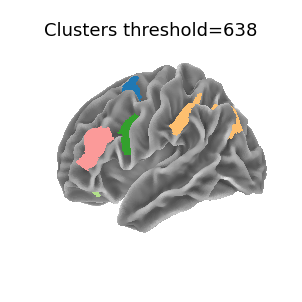

In [39]:
# Plot the clusters as a label atlas
plotting.plot_surf_roi(surf_mesh=fsaverage['white_left'], roi_map=roi_map,
threshold = 0.00001, vmax=10, colorbar=False,cmap = 'Paired',
bg_map=fsaverage['curv_left'], title='Clusters threshold=' + str(thresh))
print()

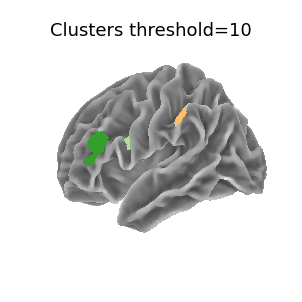

In [31]:
# Plot the clusters as a label atlas
plotting.plot_surf_roi(surf_mesh=fsaverage['white_left'], roi_map=roi_map,
threshold = 0.00001, vmax=10, colorbar=False,cmap = 'Paired',
bg_map=fsaverage['curv_left'], title='Clusters threshold=' + str(thresh))
print()

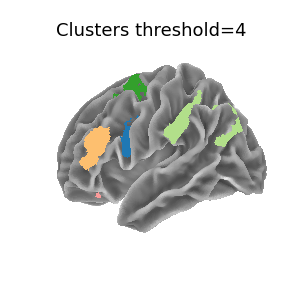

In [52]:
# Plot the clusters as a label atlas
plotting.plot_surf_roi(surf_mesh=fsaverage['white_left'], roi_map=roi_map,
threshold = 0.00001, vmax=10, colorbar=False,cmap = 'Paired',
bg_map=fsaverage['curv_left'], title='Clusters threshold=' + str(thresh))
print()

In [40]:
# syntax for interactive viewing
plotting.view_surf(fsaverage['white_left'], surf_map=roi_map,
threshold = 0.00001, vmax=10, colorbar=True,
bg_map=fsaverage['curv_left'],title='clusters thresh '+ str(thresh))

In [49]:
df_filename = analysesdir + 'ClusterMean_FisherVals_' + 'N' + str(sub_count) + '_' + task + '_ttest_thresh'+str(thresh)
roi_df.to_csv(df_filename+ '.csv')

<AxesSubplot:>

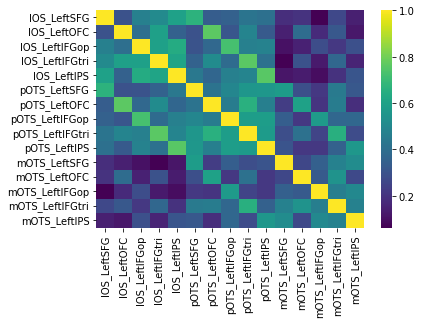

In [51]:
# plot intercorrelations between connectivity values
corrmat = roi_df.corr()
#corrmat.style.background_gradient(cmap='coolwarm') # This is another nice way to plot the correlation matrix
#but the seaborn way is prettier
sns.heatmap(corrmat,cmap='viridis')

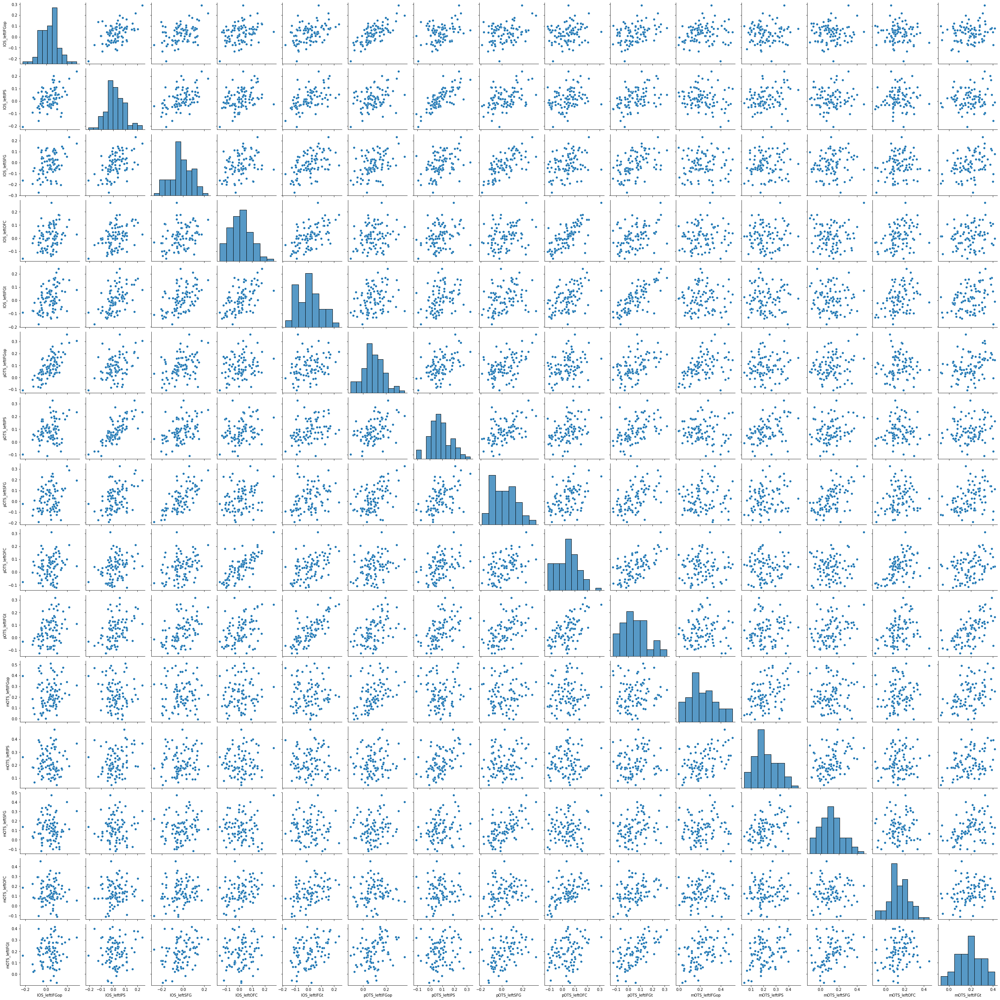

In [134]:
sns.pairplot(roi_df)

In [5]:
# syntax to find index of specific subject
sub_data.index[sub_data['participant_id']=='sub-NDARFB506UJ3'].tolist()

[51]

In [10]:
# merge behavioral df with brain df so we can filter them together
roi_df['participant_id'] = sub_data['participant_id']
all_df = pd.merge(sub_data,roi_df,how='outer', on='participant_id')

In [12]:
all_df.columns

Index(['Unnamed: 0', 'X', 'participant_id', 'preproc', 'existsRun1',
       'existsRun2', 'existsMovieDM', 'existsMovieTP', 'medianFD_run1',
       'meanFD_run1', 'maxFD_run1', 'stdFD_run1', 'FD05_run1', 'SNR_run1',
       'medianFD_run2', 'meanFD_run2', 'maxFD_run2', 'stdFD_run2', 'FD05_run2',
       'SNR_run2', 'medianFD_movieDM', 'meanFD_movieDM', 'maxFD_movieDM',
       'stdFD_movieDM', 'FD05_movieDM', 'SNR_movieDM', 'medianFD_movieTP',
       'meanFD_movieTP', 'maxFD_movieTP', 'stdFD_movieTP', 'FD05_movieTP',
       'SNR_movieTP', 'meanFD_avg', 'maxFS_avg', 'SNR_avg', 'release_number',
       'Bold.Sequence', 'Sex', 'Age', 'EHQ_Total', 'Commercial_Use',
       'Full_Pheno', 'site', 'Gender', 'WIAT_Word_Raw', 'WIAT_Word_Stnd',
       'WIAT_Num_Raw', 'WIAT_Num_Stnd', 'WIAT_Pseudo_Raw', 'WIAT_Pseudo_Stnd',
       'WIAT_MP_Raw', 'WIAT_MP_Stnd', 'Barratt_P1_Edu', 'Barratt_P2_Edu',
       'Barratt_Total_Edu', 'Barratt_P1_Occ', 'Barratt_P2_Occ',
       'Barratt_Total_Occ', 'Barratt_Total

In [10]:
# plot reading against correlation values from significant clusters
myVar = 'EHQ_Total' # options are WIAT_Word_Stnd, WIAT_Word_Raw, Age
myData = sub_data[myVar]
scat_fig, scat_axes = plt.subplots(len(roi_names),len(clusters),figsize=(20,10),sharey=True,sharex=True)
scat_fig.tight_layout(pad=0.4, w_pad=0.5, h_pad=4.0)
for roi_i in range(len(roi_names)):
    for cluster_i in range(len(clusters)):
        cluster_name = os.path.splitext(clusters[cluster_i])[0]
        cur_col = [col for col in roi_df.columns if cluster_name in col and roi_short_names[roi_i] in col]
        scat_axes[roi_i,cluster_i].scatter(myData,roi_df.loc[:,cur_col])
        scat_axes[roi_i,cluster_i].set_xlabel(myVar)#,fontsize=14)
        scat_axes[roi_i,cluster_i].set_ylabel('Connectivity (z)')#,fontsize=14)
        cor_val, p_val = stats.pearsonr(myData[~myData.isna()],roi_df.loc[:,cur_col][~myData.isna()])
        print('N = ' + str(len(myData[~myData.isna()])) + '(' + myVar + ' vs ' +cur_col[0]+ ')')
        #plt.annotate("r = {:.3f}".format(cor_val), (0, 1))
        if myVar == 'Age':
            xpos = 8
        else:
            xpos = 50
        scat_axes[roi_i,cluster_i].text(xpos, 0.4, "r = {:.3f}\np = {:.3f}".format(cor_val[0],p_val), horizontalalignment='left', size='medium', weight='semibold')
        scat_axes[roi_i,cluster_i].set_title(cur_col[0],fontsize=16)

NameError: name 'clusters' is not defined

In [11]:
# plot reading against correlation values from significant clusters
myVar = 'EHQ_Total' # options are WIAT_Word_Stnd, WIAT_Word_Raw, Age
myData = all_df[myVar]
scat_fig, scat_axes = plt.subplots(len(roi_names),len(clusters),figsize=(20,10),sharey=True,sharex=True)
scat_fig.tight_layout(pad=0.4, w_pad=0.5, h_pad=4.0)
for roi_i in range(len(roi_names)):
    for cluster_i in range(len(clusters)):
        cluster_name = os.path.splitext(clusters[cluster_i])[0]
        cur_col = [col for col in roi_df.columns if cluster_name in col and roi_short_names[roi_i] in col]
        scat_axes[roi_i,cluster_i].scatter(all_df[myVar],all_df.loc[:,cur_col])
        scat_axes[roi_i,cluster_i].set_xlabel(myVar)#,fontsize=14)
        scat_axes[roi_i,cluster_i].set_ylabel('Connectivity (z)')#,fontsize=14)
        cor_val, p_val = stats.pearsonr(myData[~all_df[myVar].isna()],all_df.loc[:,cur_col][~all_df[myVar].isna()])
        print('N = ' + str(len(myData[~myData.isna()])) + '(' + myVar + ' vs ' +cur_col[0]+ ')')
        #plt.annotate("r = {:.3f}".format(cor_val), (0, 1))
        if myVar == 'Age':
            xpos = 8
        else:
            xpos = 50
        scat_axes[roi_i,cluster_i].text(xpos, 0.4, "r = {:.3f}\np = {:.3f}".format(cor_val[0],p_val), horizontalalignment='left', size='medium', weight='semibold')
        scat_axes[roi_i,cluster_i].set_title(cur_col[0],fontsize=16)

NameError: name 'all_df' is not defined

In [60]:
# plot reading against correlation values from significant clusters
myVar = 'TOWRE_Total_Scaled' # options are WIAT_Word_Stnd, WIAT_Word_Raw, Age
myData = sub_data[myVar]
scat_fig, scat_axes = plt.subplots(len(roi_names),len(clusters),figsize=(20,10),sharey=True,sharex=True)
scat_fig.tight_layout(pad=0.4, w_pad=0.5, h_pad=4.0)
for roi_i in range(len(roi_names)):
    for cluster_i in range(len(clusters)):
        cluster_name = os.path.splitext(clusters[cluster_i])[0]
        cur_col = [col for col in roi_df.columns if cluster_name in col and roi_short_names[roi_i] in col]
        scat_axes[roi_i,cluster_i].scatter(myData,roi_df.loc[:,cur_col])
        scat_axes[roi_i,cluster_i].set_xlabel(myVar)#,fontsize=14)
        scat_axes[roi_i,cluster_i].set_ylabel('Connectivity (z)')#,fontsize=14)
        cor_val, p_val = stats.pearsonr(myData,roi_df.loc[:,cur_col])
        #plt.annotate("r = {:.3f}".format(cor_val), (0, 1))
        if myVar == 'Age':
            xpos = 8
        else:
            xpos = 50
        scat_axes[roi_i,cluster_i].text(xpos, 0.4, "r = {:.3f}\np = {:.3f}".format(cor_val[0],p_val), horizontalalignment='left', size='medium', weight='semibold')
        scat_axes[roi_i,cluster_i].set_title(cur_col[0],fontsize=16)

[nan] nan


## Run the same analysis for movie data

In [135]:
task = 'movie'
# First we load all seed-based connectivity maps

roi_maps = np.zeros(shape = (sub_count,white_left[0].shape[0],len(roi_names)))
#roi_map shape is subjects * vertices * seed

# Load all data into one array
for roi_i in range(len(roi_names)):
    cur_roi_path = datadir + 'statMaps/' + 'GroupMap_task-' + task + '_' + roi_names[roi_i] + '_N' + str(sub_count)+ '.npy'
    cur_roi_map = np.load(cur_roi_path)
    cur_roi_mean = np.nanmean(cur_roi_map,axis=0)
    roi_maps[:,:,roi_i] = cur_roi_map
 

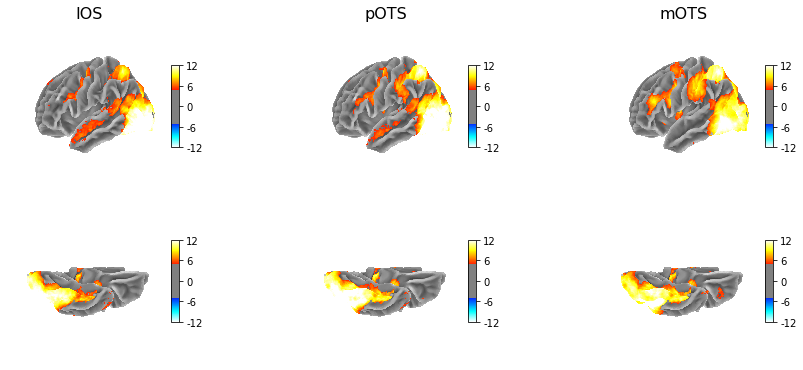

In [136]:
# create Figure
r_fig, r_axes = plt.subplots(2,len(roi_names),figsize=(14,5),sharey=True,subplot_kw={'projection': '3d'})
r_fig.tight_layout()

for roi_i in range(len(roi_names)):
    cur_roi_map = roi_maps[:,:,roi_i]
    t_vals, p_vals = stats.ttest_1samp(cur_roi_map, 0)
    z_vals = stats.norm.isf(p_vals)
    
    # Plot
    plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=z_vals,
    hemi='left', threshold = 5, vmax=12, view='lateral', colorbar=True,axes=r_axes[0,roi_i],
    bg_map=fsaverage['curv_left'],title=None)
    r_axes[0,roi_i].set_title(roi_short_names[roi_i],fontsize=16)

    plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=z_vals,
    hemi='left', threshold = 5, vmax=12, view='ventral', colorbar=True,axes=r_axes[1,roi_i],
    bg_map=fsaverage['curv_left'],title=None)

#fig.suptitle('z scores' + ' ' + task,fontsize =20)

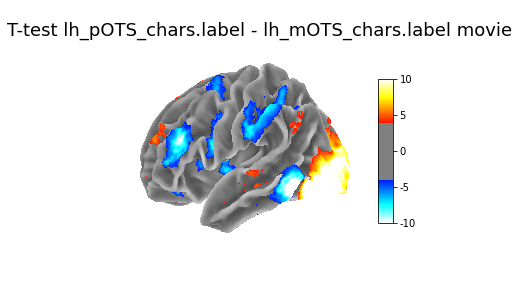

In [138]:
# Run a dependent sample t-test between the two maps
roi1_ind = 1
roi2_ind = 2
ttest_res = stats.ttest_rel(roi_maps[:,:,roi1_ind],roi_maps[:,:,roi2_ind],nan_policy='omit')
# Plot t-test result as a map
plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
hemi='left', threshold = 4, vmax=10, view='lateral', colorbar=True,
bg_map=fsaverage['curv_left'], title='T-test '+ roi_names[roi1_ind] + ' - ' + roi_names[roi2_ind] + ' ' + task, output_file = None)
print()

In [139]:
# syntax for interactive viewing
view = plotting.view_surf(fsaverage['white_left'], surf_map=ttest_res.statistic,
threshold = 4, vmax=10, colorbar=True,
bg_map=fsaverage['curv_left'],title='pOTS-mOTS')

view
view.save_as_html(datadir + 'statMaps/' + 'GroupMap_task-' + task + '_ttest_view')

In [140]:
view

## Compare rest data and movie data
##### Do seed ROIs have different connectivity patterns when subjects are watching a movie?

In [65]:
# load each roi's rest data
# load each roi's movie data
# loop through rois

# First we load all seed-based connectivity maps
# THIS SHOULD BE ONLY FOR THE SUBJECTS THAT HAVE BOTH data! 
# Filter files according to data frame. 
rest_maps = np.zeros(shape = (sub_count,white_left[0].shape[0],len(roi_names)))
movie_maps = np.zeros(shape = (sub_count,white_left[0].shape[0],len(roi_names)))
#roi_map shape is subjects * vertices * seed

# Load all data into one array
for roi_i in range(len(roi_names)):
    cur_roi_path = datadir + 'GroupMap_task-rest_' + roi_names[roi_i] + '_N' + str(sub_count)+ '.npy'
    cur_roi_map = np.load(cur_roi_path)
    rest_maps[:,:,roi_i] = cur_roi_map
    cur_roi_path = datadir + 'GroupMap_task-movie_' + roi_names[roi_i] + '_N' + str(sub_count)+ '.npy'
    cur_roi_map = np.load(cur_roi_path)
    movie_maps[:,:,roi_i] = cur_roi_map
    

In [10]:
rest_file = projectdir+ 'subs_preprocessed_onlyrest_meanFD05_SNR15_FD05_90_WIAT.csv'
movie_file = projectdir+ 'subs_preprocessed_onlymovie_meanFD05_SNR15_FD05_90_WIAT.csv'

rest_data = pd.read_csv(rest_file)
movie_data = pd.read_csv(movie_file)

In [18]:
rest_data.columns

Index(['Unnamed: 0', 'X', 'participant_id', 'preproc', 'existsRun1',
       'existsRun2', 'existsMovieDM', 'existsMovieTP', 'medianFD_run1',
       'meanFD_run1', 'maxFD_run1', 'stdFD_run1', 'FD05_run1', 'SNR_run1',
       'medianFD_run2', 'meanFD_run2', 'maxFD_run2', 'stdFD_run2', 'FD05_run2',
       'SNR_run2', 'medianFD_movieDM', 'meanFD_movieDM', 'maxFD_movieDM',
       'stdFD_movieDM', 'FD05_movieDM', 'SNR_movieDM', 'medianFD_movieTP',
       'meanFD_movieTP', 'maxFD_movieTP', 'stdFD_movieTP', 'FD05_movieTP',
       'SNR_movieTP', 'meanFD_avg', 'maxFS_avg', 'SNR_avg', 'release_number',
       'Bold.Sequence', 'Sex', 'Age', 'EHQ_Total', 'Commercial_Use',
       'Full_Pheno', 'site', 'Gender', 'WIAT_Word_Raw', 'WIAT_Word_Stnd',
       'WIAT_Num_Raw', 'WIAT_Num_Stnd', 'WIAT_Pseudo_Raw', 'WIAT_Pseudo_Stnd',
       'WIAT_MP_Raw', 'WIAT_MP_Stnd', 'Barratt_P1_Edu', 'Barratt_P2_Edu',
       'Barratt_Total_Edu', 'Barratt_P1_Occ', 'Barratt_P2_Occ',
       'Barratt_Total_Occ', 'Barratt_Total

In [19]:
# We can merge into one data frame but then we wont keep the indices to filter
# 
#both_data = pd.merge(rest_data,movie_data )
rest_keep = rest_data.loc[rest_data['existsMovieDM'] == 1]
rest_keep = meanFD_movieDM

In [27]:
my_filter = np.logical_and(rest_data['existsMovieDM'] == 1, rest_data['meanFD_movieDM'] < 0.5, rest_data['SNR_movieDM'] > 1.5)

In [28]:
sum(my_filter)

105

In [29]:
rest_data.columns

Index(['Unnamed: 0', 'X', 'participant_id', 'preproc', 'existsRun1',
       'existsRun2', 'existsMovieDM', 'existsMovieTP', 'medianFD_run1',
       'meanFD_run1', 'maxFD_run1', 'stdFD_run1', 'FD05_run1', 'SNR_run1',
       'medianFD_run2', 'meanFD_run2', 'maxFD_run2', 'stdFD_run2', 'FD05_run2',
       'SNR_run2', 'medianFD_movieDM', 'meanFD_movieDM', 'maxFD_movieDM',
       'stdFD_movieDM', 'FD05_movieDM', 'SNR_movieDM', 'medianFD_movieTP',
       'meanFD_movieTP', 'maxFD_movieTP', 'stdFD_movieTP', 'FD05_movieTP',
       'SNR_movieTP', 'meanFD_avg', 'maxFS_avg', 'SNR_avg', 'release_number',
       'Bold.Sequence', 'Sex', 'Age', 'EHQ_Total', 'Commercial_Use',
       'Full_Pheno', 'site', 'Gender', 'WIAT_Word_Raw', 'WIAT_Word_Stnd',
       'WIAT_Num_Raw', 'WIAT_Num_Stnd', 'WIAT_Pseudo_Raw', 'WIAT_Pseudo_Stnd',
       'WIAT_MP_Raw', 'WIAT_MP_Stnd', 'Barratt_P1_Edu', 'Barratt_P2_Edu',
       'Barratt_Total_Edu', 'Barratt_P1_Occ', 'Barratt_P2_Occ',
       'Barratt_Total_Occ', 'Barratt_Total

In [35]:
# filter movie dataframe by rest
my_filter_2 = (movie_data['meanFD_run1'] <0.5) & (movie_data['meanFD_run2'] <0.5) & (movie_data['SNR_run1'] >1.5) & (movie_data['SNR_run2'] >1.5)
sum(my_filter_2)

100

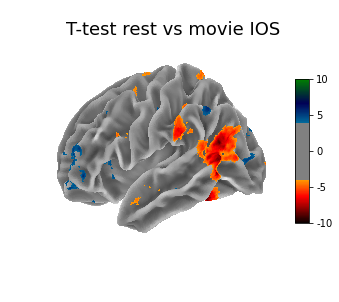

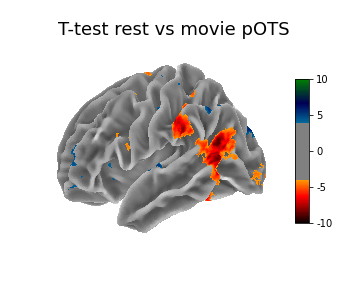

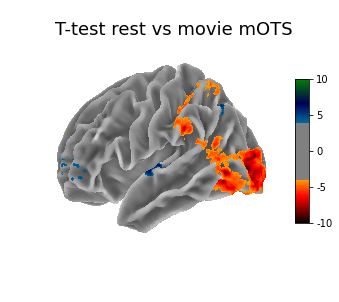

In [70]:
# Now for each ROI compare the maps
for roi_i in range(len(roi_names)):
    
    ttest_res = stats.ttest_rel(rest_maps[:,:,roi_i],movie_maps[:,:,roi_i],nan_policy='omit')
    # Plot t-test result as a map
    plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=ttest_res.statistic,
    hemi='left', threshold = 4, vmax=10, view='lateral', colorbar=True,cmap='ocean_hot_r',
    bg_map=fsaverage['curv_left'], title='T-test rest vs movie '+ roi_short_names[roi_i] + ' ', output_file = None)
    print()

# Whole brain analysis
#### Look for correlations with behavior across the entire surface

In [55]:
myVar = 'WIAT_Word_Stnd'
myData = sub_data[myVar]
behav_corr_mat = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
behav_pval_mat = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
behav_nancount = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
for roi_id in range(len(roi_names)):
    for vertex_id in range(roi_maps.shape[1]):
        brain_data = roi_maps[:,vertex_id, roi_id]
        nanvals = np.logical_or(np.isnan(brain_data), np.isnan(myData))
        rval,pval = stats.pearsonr(brain_data[~nanvals],myData[~nanvals])
        behav_corr_mat[vertex_id, roi_id] = rval
        behav_pval_mat[vertex_id, roi_id] = pval
        behav_nancount[vertex_id, roi_id] = np.sum(nanvals)

In [56]:
myData

0       96
1      110
2      105
3      117
4      104
      ... 
219    113
220    116
221    116
222     93
223    107
Name: WIAT_Word_Stnd, Length: 224, dtype: int64

In [59]:
print(behav_corr_mat[100,1])
print(behav_pval_mat[100,1])

-0.06830031597821337
0.30882274872629345


In [61]:
rval,pval = stats.pearsonr(brain_data[~nanvals],myData[~nanvals])
print(rval,pval)

0.009431499594185981 0.8883667580115988


In [99]:
# find value corresponding to a specific p value- trial and error
n = sub_count
dist = stats.beta(n/2 - 1, n/2 - 1, loc=-1, scale=2)
p = 2*dist.cdf(-abs(0.217))
print(p)

0.0010807174514105608


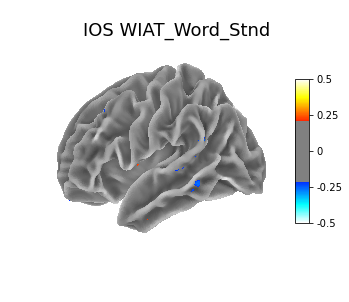

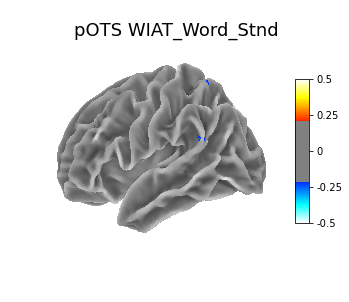

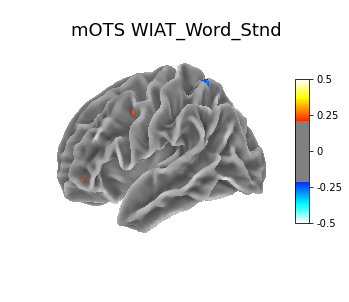

In [100]:
for roi_i in range(len(roi_names)):
    plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=behav_corr_mat[:,roi_i],
    hemi='left', threshold = 0.217, vmax=0.5, view='lateral', colorbar=True,
    bg_map=fsaverage['curv_left'], title=roi_short_names[roi_i] + ' ' + myVar,output_file = None)
    print()

In [17]:
myVar = 'Age'
myData = sub_data[myVar]
behav_corr_mat = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
behav_pval_mat = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
behav_nancount = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
for roi_id in range(len(roi_names)):
    for vertex_id in range(roi_maps.shape[1]):
        brain_data = roi_maps[:,vertex_id, roi_id]
        nanvals = np.isnan(brain_data)
        rval,pval = stats.pearsonr(brain_data[~nanvals],myData[~nanvals])
        behav_corr_mat[vertex_id, roi_id] = rval
        behav_pval_mat[vertex_id, roi_id] = pval
        behav_nancount[vertex_id, roi_id] = np.sum(nanvals)

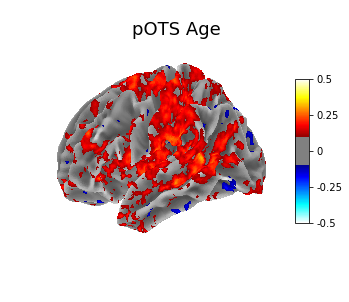

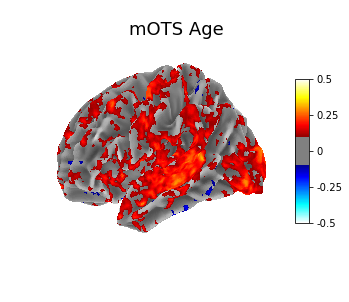

In [35]:
for roi_i in range(len(roi_names)):
    plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=behav_corr_mat[:,roi_i],
    hemi='left', threshold = 0.13, vmax=0.5, view='lateral', colorbar=True,
    bg_map=fsaverage['curv_left'], title=roi_short_names[roi_i] + ' ' + myVar,output_file = None)
    print()

In [36]:
# Test what happens when I exclude two behavioral outliers

myVar = 'WIAT_Word_Stnd'
myData = sub_data[myVar]
# Filter outliers? 
myfilter = myData > (np.nanmean(myData) - 2.5 * np.nanstd(myData))
myData = myData[myfilter]
    
behav_corr_mat = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
behav_pval_mat = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
behav_nancount = np.empty(shape=(white_left[0].shape[0],len(roi_names)))
for roi_id in range(len(roi_names)):
    for vertex_id in range(roi_maps.shape[1]):
        brain_data = roi_maps[:,vertex_id, roi_id]
        brain_data = brain_data[myfilter]
        nanvals = np.logical_or(np.isnan(brain_data), np.isnan(myData))
        rval,pval = stats.pearsonr(brain_data[~nanvals],myData[~nanvals])
        behav_corr_mat[vertex_id, roi_id] = rval
        behav_pval_mat[vertex_id, roi_id] = pval
        behav_nancount[vertex_id, roi_id] = np.sum(nanvals)

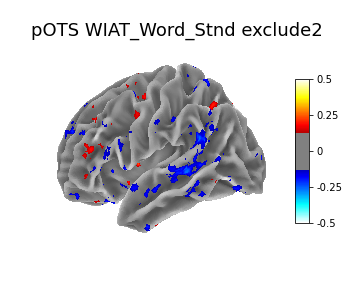

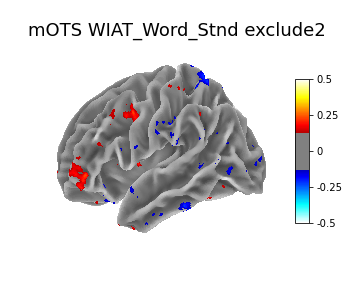

In [43]:
for roi_i in range(len(roi_names)):
    plotting.plot_surf_stat_map(fsaverage['white_left'], stat_map=behav_corr_mat[:,roi_i],
    hemi='left', threshold = 0.13, vmax=0.5, view='lateral', colorbar=True,
    bg_map=fsaverage['curv_left'], title=roi_short_names[roi_i] + ' ' + myVar + ' exclude2',output_file = None)
    print()

### Other useful syntax and things I tried

In [83]:
print(nilearn.__file__)
print(pd.__file__)

/home/users/mayay/.local/lib/python3.9/site-packages/nilearn/__init__.py
/home/users/mayay/.local/lib/python3.9/site-packages/pandas/__init__.py


In [47]:
print(nilearn.__version__)

0.9.1


In [133]:
print(sns.__version__)

0.11.2


In [22]:
import matplotlib
print(matplotlib.__version__)

3.5.0


In [84]:
#from nilearn.glm.second_level import SecondLevelModel
#second_level_model = SecondLevelModel().fit(
#    roi1_map, design_matrix=design_matrix)
#What should be the filenames?!

In [16]:
from atlasreader import create_output
file_name = '/scratch/groups/jyeatman/HBN_FC/volume/analyses/rest_N_231_ttest.nii.gz'
create_output(file_name, cluster_extent=300)

KeyboardInterrupt: 